# <center>PJM Time Series Analysis and Forecasting

**PJM** Interconnection LLC (PJM) is a regional transmission organization (RTO) in the United States.

This notebook is a study of the **PJM** energy consumption dataset and focus on the **East** coast of the US, a friend of mine "Souames Annis" worked on a similar notebook targeting the West coast.

It contains :

- An Exploratory Data Analysis.
- A Time Series Analysis through the concepts of **Seasonality** and **Stationarity**.
- A Time Series Forecasting using **Facebook Prophet** and **XGBoost** Models in order to predict future energy consumption.



<img src = './data/images/energy3.jpg' height="550" width="750">

<br>

**Data :** The dataset contains hourly data from 2002 upto 2018 on the power consumption from several companies including PJM, it's available on <a src='https://www.kaggle.com/robikscube/hourly-energy-consumption'>Kaggle</a> .




## Loading Modules

In [1]:
import numpy as np  # Scientific computing
import pandas as pd # Data analysis and manipulation

from datetime import datetime # Dates and times manipulations

# Visualization modules
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

# Plotly is a graphing library for interactive, publication-quality graphs
# pip install plotly==4.5.4
import plotly.graph_objects as go                   
import plotly.express as px
from plotly.subplots import make_subplots

import os
import warnings
warnings.filterwarnings("ignore")

## Data Loading and Cleaning

In [2]:
# Looking for the datasets names
path = './data/'
files = [file for file in os.listdir(path)]
files

['AEP_hourly.csv',
 'COMED_hourly.csv',
 'DAYTON_hourly.csv',
 'DEOK_hourly.csv',
 'DOM_hourly.csv',
 'DUQ_hourly.csv',
 'EKPC_hourly.csv',
 'est_hourly.paruqet',
 'FE_hourly.csv',
 'images',
 'NI_hourly.csv',
 'PJME_hourly.csv',
 'PJMW_hourly.csv',
 'pjm_hourly_est.csv',
 'PJM_Load_hourly.csv']

In [3]:
# Loading the PJM East energy consumption raw data
df_raw = pd.read_csv('./data/PJME_hourly.csv', index_col = 'Datetime', parse_dates = ['Datetime'])

In [4]:
# Creating a data cleaning function
def data_clean(df):
    
    # Sorting the datetime index
    df.sort_index(inplace = True)
    
    # Dropping datetime duplicates
    df = df[~df.index.duplicated()]
    
    # Setting the frequence to be Hourly
    df = df.asfreq('H')
    
    # Renaming the PJME_MW column to energy
    df.rename(columns = {'PJME_MW' : 'energy'}, inplace = True)
    
    # Filling the Missing values using the preceding values
    df.energy = df.energy.fillna(method = 'ffill')
    
    return df

In [5]:
# Creating a clean dataframe from the raw data
df_clean = data_clean(df_raw)
df_clean.head()

,energy
Datetime,
2002-01-01 01:00:00,30393.0
2002-01-01 02:00:00,29265.0
2002-01-01 03:00:00,28357.0
2002-01-01 04:00:00,27899.0
2002-01-01 05:00:00,28057.0


In [6]:
df_clean.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 145392 entries, 2002-01-01 01:00:00 to 2018-08-03 00:00:00
Freq: H
Data columns (total 1 columns):
energy    145392 non-null float64
dtypes: float64(1)
memory usage: 2.2 MB


In [7]:
df_clean.describe()

,energy
count,145392.000000
mean,32079.051915
std,6464.154020
min,14544.000000
25%,27571.000000
50%,31420.000000
75%,35647.250000
max,62009.000000


# <center>Exploratory Data Analysis

In [8]:
# Creating a function to extract some features
def data_prep(df):
    df['year'] = df.index.year
    df['month'] = df.index.month
    df['month_name'] = df.index.month_name()
    df['week_of_year'] = df.index.weekofyear
    df['quarter'] = df.index.quarter
    df['day_of_week'] = df.index.dayofweek
    df['day_of_week_name'] = df.index.weekday_name
    df['day_of_month'] = df.index.day
    df['day_of_year'] = df.index.dayofyear
    df['hour'] = df.index.hour
    
    return df

In [9]:
# Adding useful features to the cleaned dataframe
df = data_prep(df_clean)
df.head()

,energy,year,month,month_name,week_of_year,quarter,day_of_week,day_of_week_name,day_of_month,day_of_year,hour
Datetime,,,,,,,,,,,
2002-01-01 01:00:00,30393.0,2002,1,January,1,1,1,Tuesday,1,1,1
2002-01-01 02:00:00,29265.0,2002,1,January,1,1,1,Tuesday,1,1,2
2002-01-01 03:00:00,28357.0,2002,1,January,1,1,1,Tuesday,1,1,3
2002-01-01 04:00:00,27899.0,2002,1,January,1,1,1,Tuesday,1,1,4
2002-01-01 05:00:00,28057.0,2002,1,January,1,1,1,Tuesday,1,1,5


In [10]:
# Creating times grouped dataframes in order to analyse them
df_year = df.groupby('year')['energy'].sum()
df_month = df.groupby('month_name', sort = False)['energy'].sum()
df_week_of_year = df.groupby('week_of_year')['energy'].sum()
df_quarter = df.groupby('quarter')['energy'].sum()
df_day_of_week = df.groupby('day_of_week_name', sort = False)['energy'].sum()
df_day_of_month = df.groupby('day_of_month')['energy'].sum()
df_day_of_year = df.groupby('day_of_year')['energy'].sum()
df_hour = df.groupby('hour')['energy'].sum()

### Plotting the grouped dataframes

In [11]:
# Creating a plotly subplot
fig = make_subplots(rows=4, cols=2, vertical_spacing = 0.175,
                    subplot_titles=(['Year', 'Month', 'Day of Week', 'Day of Month', 'Week of Year', 'Day of year', 'Hour', 'Quarter']))

fig.add_trace(go.Scatter(x=df_year.index, y = df_year), row=1, col=1)
fig.add_trace(go.Scatter(x=df_month.index, y=df_month), row=1, col=2)
fig.add_trace(go.Scatter(x=df_week_of_year.index, y=df_week_of_year), row=3, col=1)
fig.add_trace(go.Scatter(x=df_day_of_week.index, y=df_day_of_week), row=2, col=1)
fig.add_trace(go.Scatter(x=df_day_of_month.index, y=df_day_of_month), row=2, col=2)
fig.add_trace(go.Scatter(x=df_day_of_year.index, y=df_day_of_year), row=3, col=2)
fig.add_trace(go.Scatter(x=df_hour.index, y=df_hour), row=4, col=1)
fig.add_trace(go.Scatter(x=df_quarter.index, y=df_quarter), row=4, col=2)

fig.update_layout(title = 'Energy Consumption of PJME per', height = 700, width = 950, showlegend = False)

fig.show()

### Analysing the results

- The yearly energy consumption of PJME is constant from 2002 to 2015, a slight decreasing trend is observed from 2015 to 2017, probably due to electrical energy reduction awarness these last 5 years. 

    The data for the year 2018 is incomplete which explains the abrupt reduction.
<br>

- The monthly energy consumption is as expected, a high demande in the summer with a peak in the month of July, probably due to to excessive use of the air conditioners. These months should be target for electrical energy reduction awarness campain. 

    A Second pulse is however observed Between December and January probably due to the events, especially Christmas and New Year's Eve.
<br>

- The weekly energy consumption can be devided as, a high constant demand during the working days due to the to factories, and a relatively smaller demand during weekends.
<br>

- The hourly energy consumption is predictible, an increase from 6AM to 8PM with a peak at 6PM due to households consumption. Then a decrease until 5AM.


- The week of year, day of year and quarter energy consumption demands graph are similar to the monthly destibution.


<br>

# <center> Time Series

A **time series** is a series of data points indexed in time order. 

Most commonly, the data points are equally spaced points in time, and the observations can be taken on any variable that changes over time.

In our case we are studying an **Hourly energy consumption time series**.

In [187]:
# Plotting the time series
fig = px.line(df, x=df.index, y = df.energy)

fig.update_layout(title = "Energy Consumption of PJME from 2002 to 2018", 
                  yaxis_title="Energy (MW)", 
                  xaxis_title="Date", 
                  xaxis_rangeslider_visible=True)
fig.show()

**Note :** 

- We see that the energy consumption on the end of october 2012 is relatively low, compared to the rest of the distribution. This is due to **Hurricane Sandy** who was the deadliest and most destructive, as well as the strongest, hurricane of the 2012 Atlantic hurricane season. Inflicting nearly 70 billion (2012 USD) in damage, it was the second-costliest hurricane on record in the United States until surpassed by Hurricanes Harvey and Maria in 2017.

<br>

# <center>1 Time Series Analysis

**Time series analysis** comprises methods for analyzing data in order to extract meaningful statistics and other characteristics of the data.

Let's analyse 2 main aspects of our time series : Seasonality and Stationarity.

## <center>1.2 Seasonality

**seasonality** is the presence of variations that occur at specific regular intervals such as weekly, monthly, quarterly or yearly.

We are gonna use the Seasonal decomposition with the moving averages from the Statsmodel librairy, and test multiple seasonalities.

In [13]:
from statsmodels.tsa.seasonal import seasonal_decompose

Two types of seasonal model can be used **Additive** and **Multiplicative**.

In [17]:
# Since our time series has an hourly frequence, we can set the seasonal decomposition frequence to
# 24 * 365 = 8760 to capture any Yearly seasonality
# 24 * 30.5 = 732 to capture any Montly seasonality
# And so on ....
year_period = int(24 * 365)
month_period = int(24 * 30.5)

s_dec_additive = seasonal_decompose(df.energy, freq = year_period, model = 'additive')
s_dec_multiplicative = seasonal_decompose(df.energy, freq = year_period, model = 'multiplicative')

s_dec_additive_monthly = seasonal_decompose(df[:year_period].energy, freq = month_period, model = 'additive')
s_dec_multiplicative_monthly = seasonal_decompose(df[:year_period].energy, freq = month_period, model = 'multiplicative')

The decomposition will lead to three components -- trend, seasonal and residual.
- The trend component captures the slowly-moving overall level of the series.
- The seasonal component captures patterns that repeat every season.
- The residual is what is left. It may or may not be autocorrelated.

In [ ]:
# Plotting the components
def plot_seasonal(res, axes, model):
    axes[0].set_title(model)
    res.observed.plot(ax=axes[0], legend=False)
    axes[0].set_ylabel('Observed')
    res.trend.plot(ax=axes[1], legend=False)
    axes[1].set_ylabel('Trend')
    res.seasonal.plot(ax=axes[2], legend=False)
    axes[2].set_ylabel('Seasonal')
    res.resid.plot(ax=axes[3], legend=False)
    axes[3].set_ylabel('Residual')

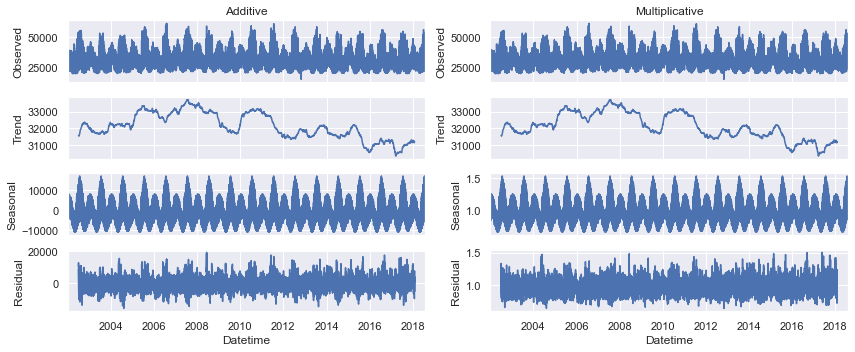

In [18]:
# Plotting the yearly seasonal decompose
fig, axes = plt.subplots(ncols=2, nrows=4, sharex=True, figsize=(12,5))

plot_seasonal(s_dec_additive, axes[:,0], 'Additive')
plot_seasonal(s_dec_multiplicative, axes[:,1], 'Multiplicative')

plt.tight_layout()
plt.show()

**Analysing the results :** we observe a concrete cyclical pattern from the seasonal graph of each model.

$\Longrightarrow$ Our data is Yearly Seasonal.

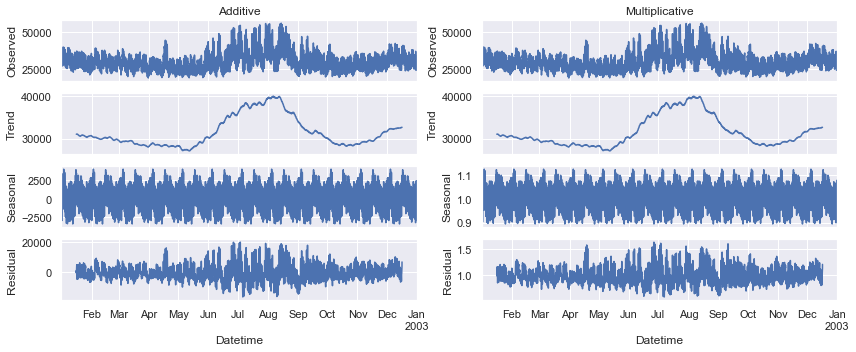

In [24]:
# Plotting the monthly seasonal decompose
fig, axes = plt.subplots(ncols=2, nrows=4, sharex=True, figsize=(12,5))

plot_seasonal(s_dec_additive_monthly, axes[:,0], 'Additive')
plot_seasonal(s_dec_multiplicative_monthly, axes[:,1], 'Multiplicative')

plt.tight_layout()
plt.show()

**Analysing the results :** we observe a cyclical pattern too.

$\Longrightarrow$ Our data is also Monthly Seasonal.

**Note :** We are going to use a Facebook Prophet model and an XGBoost model, so we don't need to specify every seasonality, since the models can recognise most of the cyclical patterns.

## <center>1.2 Stationarity

In the most intuitive sense, **stationarity** means that the statistical properties of a process generating a time series do not change over time. 

It does not mean that the series does not change over time, just that the way it changes does not itself change over time.

For example :

<img src = 'https://upload.wikimedia.org/wikipedia/commons/e/e1/Stationarycomparison.png'>

### How do we test Stationarity ?

In statistics and econometrics, an **Augmented Dickey–Fuller test (ADF)** tests the null hypothesis that a unit root is present in a time series sample. 

The alternative hypothesis is different depending on which version of the test is used, in our case we are testing **stationarity**.

In [95]:
import statsmodels.tsa.stattools as sts

The **Augmented Dickey–Fuller (ADF)** statistic, used in our test, is a negative number. The more negative it is, the stronger the rejection of the hypothesis that there is a unit root at some level of confidence.

In [102]:
# Running the Adfuller test
adfuller = sts.adfuller(df.energy)

# Extracting the test and critical values
test_value, critical_values = adfuller[0], adfuller[4]

In [103]:
print(f'The test value : \t{test_value}\nThe critical values : \t{critical_values}')

The test value : 	-19.968326491370576
The critical values : 	{'1%': -3.4303950013454645, '5%': -2.8615598899580115, '10%': -2.5667805867167433}


**Analysing the results :** Our test value is lower than the critical values for 1%, 5% and 10 %.

$\Longrightarrow$ We rejet the null hypothesis
$\Longrightarrow$ Our data is Stationary
<br><br><br>

# <center>2 Time Series Forecasting

Time seriesforecasting is the use of a model to predict future values based on previously observed values.

### Data Splitting

The Train-set will be 80% and the Test-set 20% of the complete dataframe.

In [31]:
# Creating a function to split the data into train and test based on a given size
def data_split(df, size):
    return df[:size], df[size:]

In [86]:
# Setting up the size
size = int(0.8 * len(df))

# Creating the train and test dataframes
train, test = data_split(df_clean, size)

train_hours = len(train)
test_hours = len(test)

print(f'{str(train.energy.tail())} \n\n {str(test.energy.head())}')

Datetime
2015-04-09 05:00:00    25198.0
2015-04-09 06:00:00    27201.0
2015-04-09 07:00:00    30591.0
2015-04-09 08:00:00    32373.0
2015-04-09 09:00:00    32898.0
Freq: H, Name: energy, dtype: float64 

 Datetime
2015-04-09 10:00:00    33082.0
2015-04-09 11:00:00    33285.0
2015-04-09 12:00:00    33148.0
2015-04-09 13:00:00    32809.0
2015-04-09 14:00:00    32613.0
Freq: H, Name: energy, dtype: float64


In [35]:
# Plotting the dataframes
fig = make_subplots()

fig.add_trace(go.Line(x = train.index, y = train.energy, name = "Train") )

fig.add_trace(go.Line(x = test.index, y = test.energy, name = 'Test'))

fig.update_layout(title = "Energy Consumption of PJME / Train and Test", 
                  yaxis_title="Energy (MW)", 
                  xaxis_title="Date", xaxis_rangeslider_visible=True)

fig.show()

## <center>2.1 Facebook Prophet

Prophet is a framework from facebook to forecast time series by decomposing the time series into components: trend, seasonality, Holidays and residuals.

$$ x(t) = T(t) + S(t) + H(t) + \epsilon(t) $$

$S(t)$ is approximated using a fourier series with a period $P = 365$ by default, we can choose the fourier order $n$ of each seasonality:

$$ \sum_{i=1}^n a_n cos( \frac{n\pi}{P} t ) + b_n sin( \frac{n\pi}{P} t  ) $$

In [37]:
from fbprophet import Prophet

### Data Preparation 

The input to Prophet is always a dataframe with two columns: ds and y.
- The ds (datestamp) column should be a date or timestamp format.
- The y column must be numeric, and represents the measurement we wish to forecast.

In [38]:
# Creating a function to prepare our data
def data_prep_prophet(df):
    return df.reset_index().copy().rename(columns = {'Datetime' : 'ds', 'energy':'y'})[['ds', 'y']]

In [40]:
train_p = data_prep_prophet(train)
train_p.head()

,ds,y
0,2002-01-01 01:00:00,30393.0
1,2002-01-01 02:00:00,29265.0
2,2002-01-01 03:00:00,28357.0
3,2002-01-01 04:00:00,27899.0
4,2002-01-01 05:00:00,28057.0


### Modeling and Forecasting

In [41]:
# Instantiating a new Prophet object with Multiple Seasonalities
model_p = Prophet(yearly_seasonality=True)
model_p.add_seasonality(name='monthly', period = month_period, fourier_order=5)

# Fitting the model to the train dataframe
model_p.fit(train_p);

In [42]:
# Setting up the period of prediction to be the length of the test Hours in the future
future_p = model_p.make_future_dataframe(periods = test_hours, freq = 'H')

# Creating a forecast dataframe that contains the forecasted values - yhat 
forecast_p = model_p.predict(future_p)

forecast_p[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
145387,2018-08-02 20:00:00,41733.831306,14240.649739,69576.022939
145388,2018-08-02 21:00:00,40962.707067,13619.557951,69586.836314
145389,2018-08-02 22:00:00,39332.812272,12486.430167,67532.085377
145390,2018-08-02 23:00:00,37130.243319,9830.996317,66108.666729
145391,2018-08-03 00:00:00,34818.549170,7205.050707,63286.351078


In [43]:
# Saving the forcast into a csv file
forecast_p.to_csv('forecast_p.csv')

### Plotting the Forecast and Components

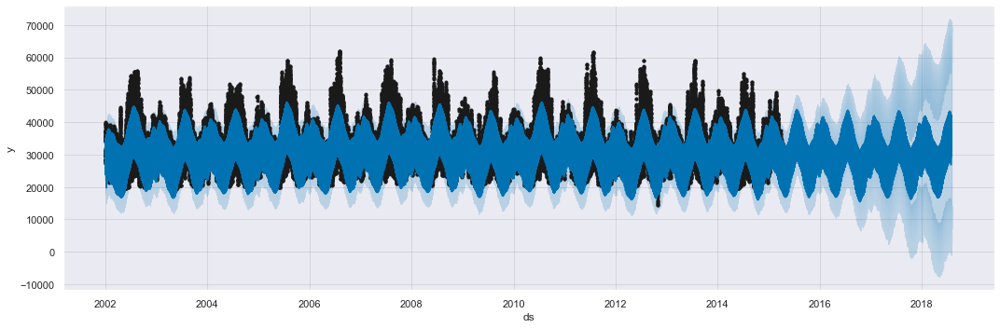

In [44]:
fig, ax = plt.subplots(1, figsize=(15,5))
model_p.plot(forecast_p, ax = ax);

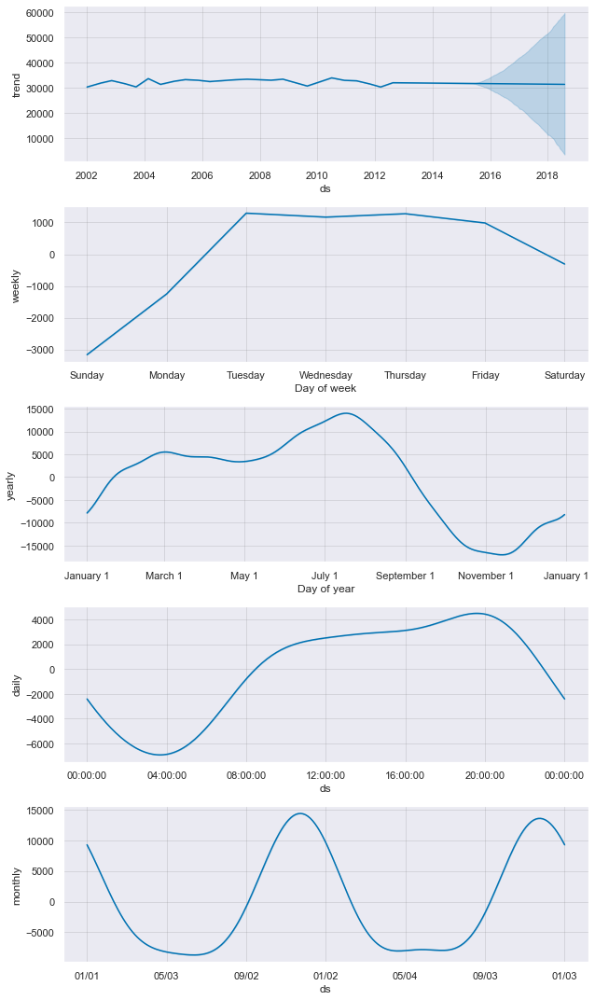

In [45]:
model_p.plot_components(forecast_p);

**Analysing the results :** As we can see the prophet model has been able to recognize multiple seasonalities and extract the constant trend.

Let's plot the forecasted and test values, to visually see how our model performed.

### Plotting the test with the forecast results

In [112]:
# Creating a funtion to Plot the test with the forecast results
def plot_forecast_test(test, forecast, model):
    fig = make_subplots()

    fig.add_trace(go.Line(x=test.index, y=test.energy, name = 'Test'))
    fig.add_trace(go.Line(x=forecast.ds, y = forecast.yhat, name = "Forecast") )

    fig.update_layout(title = "Energy Consumption of PJME / Forecast VS Test / {}".format(model), 
                      yaxis_title="Energy (MW)", 
                      xaxis_title="Date", 
                      xaxis=dict(
                          rangeselector=dict(
                              buttons=list([
                                  dict(count=1, label="1m", step ="month", stepmode="backward"),
                                  dict(count=6, label="6m", step ="month", stepmode="backward"),
                                  dict(count=1, label="1y", step ="year", stepmode="backward"),
                                  dict(step="all")
                              ])
                          ),
                          rangeslider=dict(visible=True),
                          type="date")
                     )
    return fig.show()

In [113]:
plot_forecast_test(test, forecast_p[train_hours:], 'Prophet')

**Analysing the results :** As we can see the model performs well, but has trouble predicting peak demands. Most of the time he doesn't go for the high values.

<br>

## <center>2.2 XGBoost

XGBoost is a high performance implementation of the gradient boosting framework, in this case if we have $k$ regression trees, where each tree optimize the previous one, we can define the predicted target $\hat{y}$ as:

$$\hat{y}_i = \sum_{k=1}^K f_k(x_i), f_k \in \mathcal{F}$$

We wish to minimize the following objective function: (loss + regularization (either $L^1$ or $L^2$))

$$ \text{obj}(\theta) = \sum_i^n l(y_i, \hat{y}_i) + \sum_{k=1}^K \Omega(f_k) $$

In [28]:
import xgboost as xgb

### Data Preparation

In [88]:
# Defining the features
features = ['year', 'month', 'week_of_year', 'quarter', 'day_of_week', 'day_of_month', 'day_of_year', 'hour']

X_train, y_train = train[features], train['energy']
X_test, y_test = test[features], test['energy']

### Modeling and Forecasting

In [102]:
# Fitting XGB regressor 
model_xgb = xgb.XGBRegressor()
model_xgb.fit(X_train, y_train)
print(model_xgb)

XGBRegressor(base_score=0.5, booster=None, colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints=None,
             learning_rate=0.300000012, max_delta_step=0, max_depth=6,
             min_child_weight=1, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=0, num_parallel_tree=1,
             objective='reg:squarederror', random_state=0, reg_alpha=0,
             reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method=None,
             validate_parameters=False, verbosity=None)


In [103]:
# Making the prediction on the X_test set 
future_xgb = model_xgb.predict(data = X_test)

# Creating the forecast dataframe
forecast_xgb = pd.DataFrame()
forecast_xgb['ds'] = X_test.index
forecast_xgb["yhat"] = future_xgb

forecast_xgb.tail()

,ds,Prediction
29074,2018-08-02 20:00:00,39278.679688
29075,2018-08-02 21:00:00,38547.921875
29076,2018-08-02 22:00:00,37062.972656
29077,2018-08-02 23:00:00,34418.234375
29078,2018-08-03 00:00:00,28446.685547


In [111]:
# Saving the forcast into a csv file
forecast_xgb.to_csv("forecast_xgb.csv")

### Plotting the test with the forecast results

In [114]:
plot_forecast_test(test, forecast_xgb, 'XGBoost')

**Analysing the results :** We can see that our XGBoost model fits our test data pretty well, even better than the Prophet model. He's reaching for high values to predict high peaks demands.

But we can't visually decide which one is better, let's run some error metrics measurements to to make up our mind.


<br>

## <center>Error Metrics

An **Error Metric** is a type of Metric used to measure the error of a forecasting model. They can provide a way for forecasters to quantitatively compare the performance of competing models. 

Some common error metrics are:
- Mean Squared Error (MSE)
- Root Mean Square Error (RMSE)
- Mean Absolute Error (MAE)
- Mean Absolute Percentage Error (MAPE)

In [48]:
from sklearn.metrics import mean_squared_error, mean_absolute_error

Some metrics are note available on the sklearn librairy let's define them.

In [73]:
def mean_absolute_percentage_error(y_true, y_pred):
    """Calculates MAPE given y_true and y_pred"""
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# Creating an error metrics printing function
def print_err(y_true, y_pred):
    print('MSE   :\t', round(mean_squared_error(y_true, y_pred), 3))
    print('RMSE  :\t', round(np.sqrt(mean_squared_error(y_true, y_pred)), 3))
    print('MAE   :\t', round(mean_absolute_error(y_true, y_pred), 3))
    print('MAPE  :\t', round(mean_absolute_percentage_error(y_true, y_pred), 3), '%')

Let's define the true values from the test dataset and predicted values from the forecasted datasets.

In [109]:
y_true = test.energy
y_pred_p = forecast_p[train_hours:].yhat
y_pred_xgb = forecast_xgb.yhat

### Error metrics of the Prophet model 

In [74]:
print_err(y_true, y_pred_p)

MSE   :	 17680983.029
RMSE  :	 4204.876
MAE   :	 3272.917
MAPE  :	 10.431 %


### Error metrics of the XGBoost model 

In [101]:
print_err(y_true, y_pred_xgb)

MSE   :	 18671653.797
RMSE  :	 4321.071
MAE   :	 3219.008
MAPE  :	 10.203 %


<br>
The results are quite similar for both models:

- A high **MSE**, **RMSE** due to the natural dispersion of our intial data (Standard deviation $\sigma = 6464$). With a slight advantage for Prophet.
    
- A 10% **MAPE** for both models, which is very precise and accurate.  With a slight advantage for XGBoost.

<br>

# Conclusion

The **EDA** allowed us to extract informations about the general patterns of the energy consumption in the East region of America. These patterns are most of the time Seasonal (cyclical) patterns.

How can we improve the basic EDA ?
- Calculting some ratios and percentages, for exemple, what is the percentage of energy consumption of households in comparison to society in general?
- Gathering recent energy consumption data, in order to see if the slight decreasing trend continues continue over the year.
- Using cross analysis to extract more insights, for exemple, how daily trends change depending of the time of year ?


The **Time Series** study allowed us to predict energy consumption using two powerful models with similar and precise results.




<br>

### Created By MEBREK Brahim.